In [91]:
import openeo
from pprint import pprint
import rasterio
import matplotlib.pyplot as plt
import numpy as np
from skimage import exposure

In [92]:
connection = openeo.connect("openeo.dataspace.copernicus.eu").authenticate_oidc()

Authenticated using refresh token.


# 2018 Carr Fire

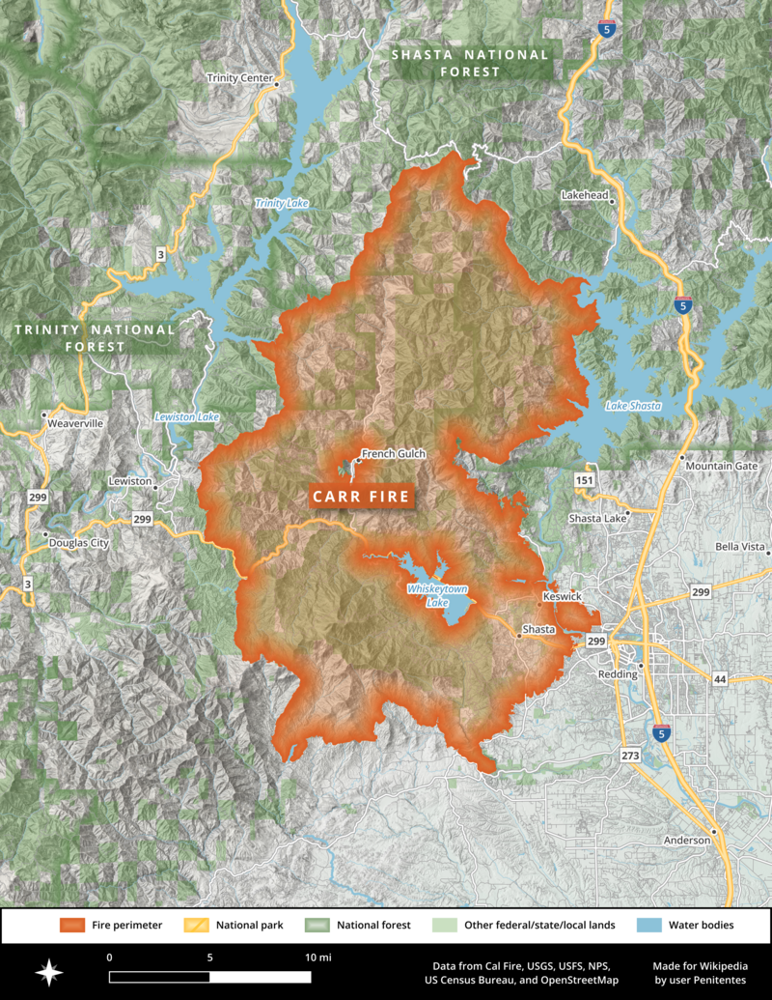

In [151]:
extent = {"west": -122.9, "south": 40.4, "east": -122.2, "north": 41}

In [152]:
pre_temporal_extent = ["2017-04-22", "2017-07-22"]
nrt_temporal_extent = ["2018-07-23", "2018-08-30"]
post_temporal_extent = ["2018-08-31", "2018-11-30"]



Sentinel-2 L2A Bands

- Name	Description	Resolution
- B01	Coastal aerosol, 442.7 nm (S2A), 442.3 nm (S2B)	60m
- B02	Blue, 492.4 nm (S2A), 492.1 nm (S2B)	10m
- B03	Green, 559.8 nm (S2A), 559.0 nm (S2B)	10m
- B04	Red, 664.6 nm (S2A), 665.0 nm (S2B)	10m
- B05	Vegetation red edge, 704.1 nm (S2A), 703.8 nm (S2B)	20m
- B06	Vegetation red edge, 740.5 nm (S2A), 739.1 nm (S2B)	20m
- B07	Vegetation red edge, 782.8 nm (S2A), 779.7 nm (S2B)	20m
- B08	NIR, 832.8 nm (S2A), 833.0 nm (S2B)	10m
- B8A	Narrow NIR, 864.7 nm (S2A), 864.0 nm (S2B)	20m
- B09	Water vapour, 945.1 nm (S2A), 943.2 nm (S2B)	60m
- B11	SWIR, 1613.7 nm (S2A), 1610.4 nm (S2B)	20m
- B12	SWIR, 2202.4 nm (S2A), 2185.7 nm (S2B)	20m
- AOT	Aerosol Optical Thickness map, based on Sen2Cor processor	10m
- SCL	Scene classification data, based on Sen2Cor processor, codelist	20m
- SNW	Snow probability, based on Sen2Cor processor	20m
- CLD	Cloud probability, based on Sen2Cor processor	20m
- CLP	Cloud probability, based on s2cloudless (more)	160m
- CLM	Cloud masks (more)	160m
- sunAzimuthAngles	Sun azimuth angle	5000m
- sunZenithAngles	Sun zenith angle	5000m
- viewAzimuthMean	Viewing azimuth angle	5000m
- viewZenithMean	Viewing zenith angle	5000m
- dataMask	The mask of data/no data pixels (more).	N/A*

In [169]:
s2_cube_pre = connection.load_collection(
        "SENTINEL2_L2A",
        temporal_extent=pre_temporal_extent,
        spatial_extent=extent,
        bands=["B02", "B03", "B04", "B08", "B8A", "B11", "B12"],
        max_cloud_cover=10,
    )

In [117]:
s2_cube_nrt = connection.load_collection(
        "SENTINEL2_L2A",
        temporal_extent=nrt_temporal_extent,
        spatial_extent=extent,
        bands=["B02", "B03", "B04", "B08", "B8A", "B11", "B12"],
        max_cloud_cover=10,
    )

In [153]:
s2_cube_post = connection.load_collection(
        "SENTINEL2_L2A",
        temporal_extent=post_temporal_extent,
        spatial_extent=extent,
        bands=["B02", "B03", "B04", "B08", "B8A", "B11", "B12"],
        max_cloud_cover=10,
    )

## NRT

In [83]:
cube_s2_b2_nrt = s2_cube_nrt.filter_bands(bands = ["B02"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
cube_s2_b3_nrt = s2_cube_nrt.filter_bands(bands = ["B03"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
cube_s2_b4_nrt = s2_cube_nrt.filter_bands(bands = ["B04"]).mean_time().resample_spatial(resolution=100, method="cubicspline")

cube_s2_b2_nrt.download("./data/nrt_b2_resampled.tiff")
cube_s2_b3_nrt.download("./data/nrt_b3_resampled.tiff")
cube_s2_b4_nrt.download("./data/nrt_b4_resampled.tiff")

In [121]:
band2=rasterio.open("./data/nrt_b2_resampled.tiff")
band3=rasterio.open("./data/nrt_b3_resampled.tiff")
band4=rasterio.open("./data/nrt_b4_resampled.tiff")

In [85]:
band2_geo = band2.profile
band2_geo.update({"count": 3})

In [86]:
with rasterio.open('rgb.tiff', 'w', **band2_geo) as dest:
# I rearanged the band order writting to 2→3→4 instead of 4→3→2
    dest.write(band2.read(1),1)
    dest.write(band3.read(1),2)
    dest.write(band4.read(1),3)

# Plot the RGB image
#show(image.transpose(2,0,1), transform=img.transform)

In [88]:
# Rescale the image (divide by 10000 to convert to [0:1] reflectance
img = rasterio.open('rgb.tiff')
image = np.array([img.read(3), img.read(2), img.read(1)]).transpose(1,2,0)
p2, p98 = np.nanpercentile(image, (2,98))
image = exposure.rescale_intensity(image, in_range=(p2, p98)) #/ 100000

In [56]:
image.shape

(6692, 5948, 3)

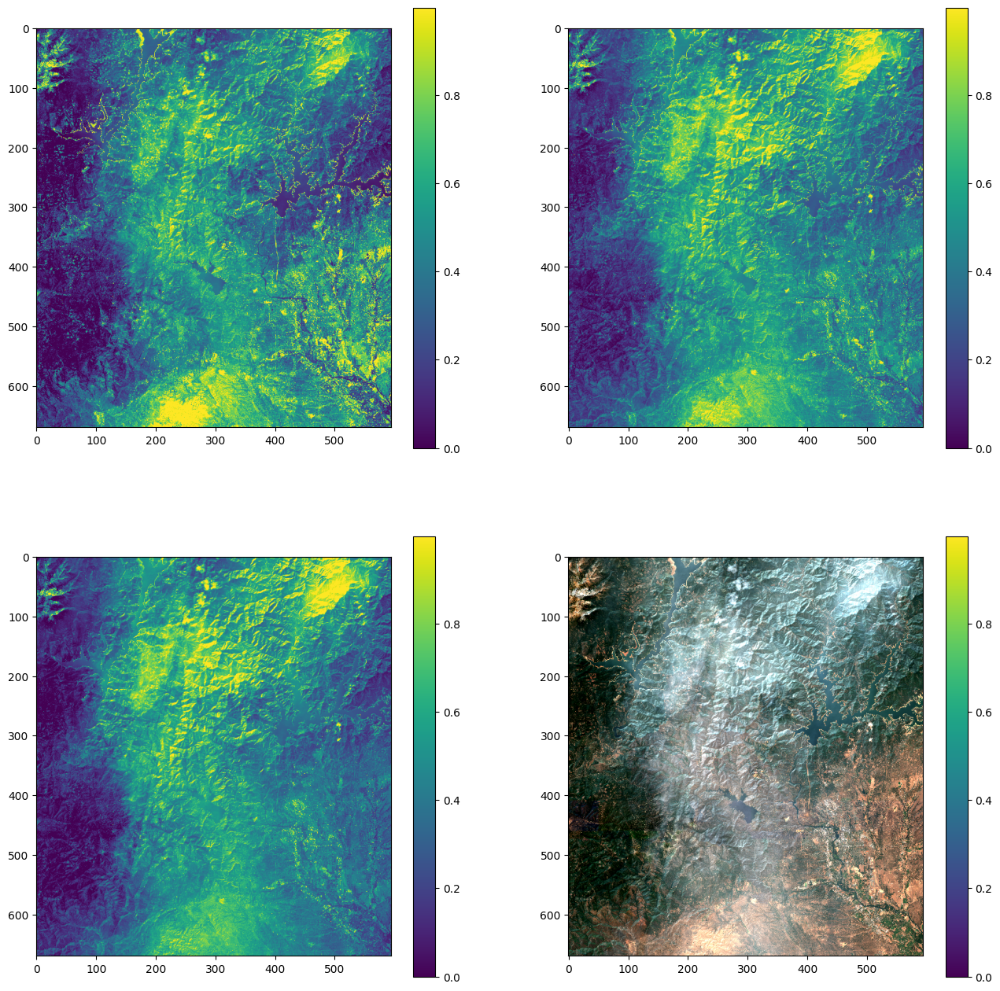

In [89]:
plt.figure(figsize=(16, 16))
plt.subplot(221)
plt.imshow(image[:,:,0])
plt.colorbar()
plt.subplot(222)
plt.imshow(image[:,:,1])
plt.colorbar()
plt.subplot(223)
plt.imshow(image[:,:,2])
plt.colorbar()
plt.subplot(224)
plt.imshow(image)
plt.colorbar()

## PRE

In [ ]:
cube_s2_b2_pre = s2_cube_pre.filter_bands(bands = ["B02"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
cube_s2_b3_pre = s2_cube_pre.filter_bands(bands = ["B03"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
cube_s2_b4_pre = s2_cube_pre.filter_bands(bands = ["B04"]).mean_time().resample_spatial(resolution=100, method="cubicspline")

cube_s2_b2_pre.download("./data/pre_b2_resampled.tiff")
cube_s2_b3_pre.download("./data/pre_b3_resampled.tiff")
cube_s2_b4_pre.download("./data/pre_b4_resampled.tiff")

In [63]:
band2_pre=rasterio.open("./data/pre_b2_resampled.tiff")
band3_pre=rasterio.open("./data/pre_b3_resampled.tiff")
band4_pre=rasterio.open("./data/pre_b4_resampled.tiff")

In [52]:
band2_geo = band2_pre.profile
band2_geo.update({"count": 3})

with rasterio.open('rgb_pre.tiff', 'w', **band2_geo) as dest:
# I rearanged the band order writting to 2→3→4 instead of 4→3→2
    dest.write(band2_pre.read(1),1)
    dest.write(band3_pre.read(1),2)
    dest.write(band4_pre.read(1),3)

In [60]:
img = rasterio.open('rgb_pre.tiff')
image = np.array([img.read(3), img.read(2), img.read(1)]).transpose(1,2,0)
p2, p98 = np.nanpercentile(image, (2,98))
image_pre = exposure.rescale_intensity(image, in_range=(p2, p98)) #/ 100000

In [54]:
p2

np.float64(144.94252197265624)

In [64]:
p98

np.float64(1900.1859179687478)

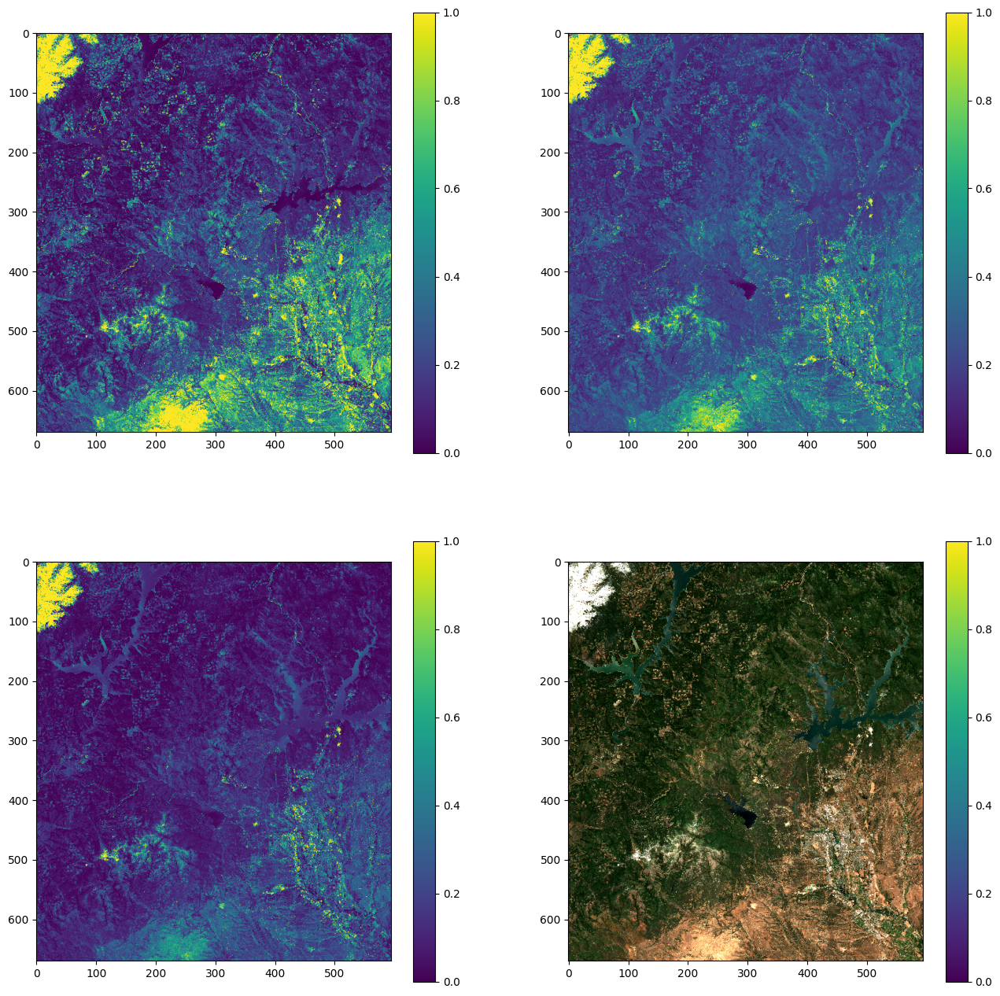

In [61]:
plt.figure(figsize=(16, 16))
plt.subplot(221)
plt.imshow(image_pre[:,:,0])
plt.colorbar()
plt.subplot(222)
plt.imshow(image_pre[:,:,1])
plt.colorbar()
plt.subplot(223)
plt.imshow(image_pre[:,:,2])
plt.colorbar()
plt.subplot(224)
plt.imshow(image_pre)
#plt.clim([0,0.2])
plt.colorbar()

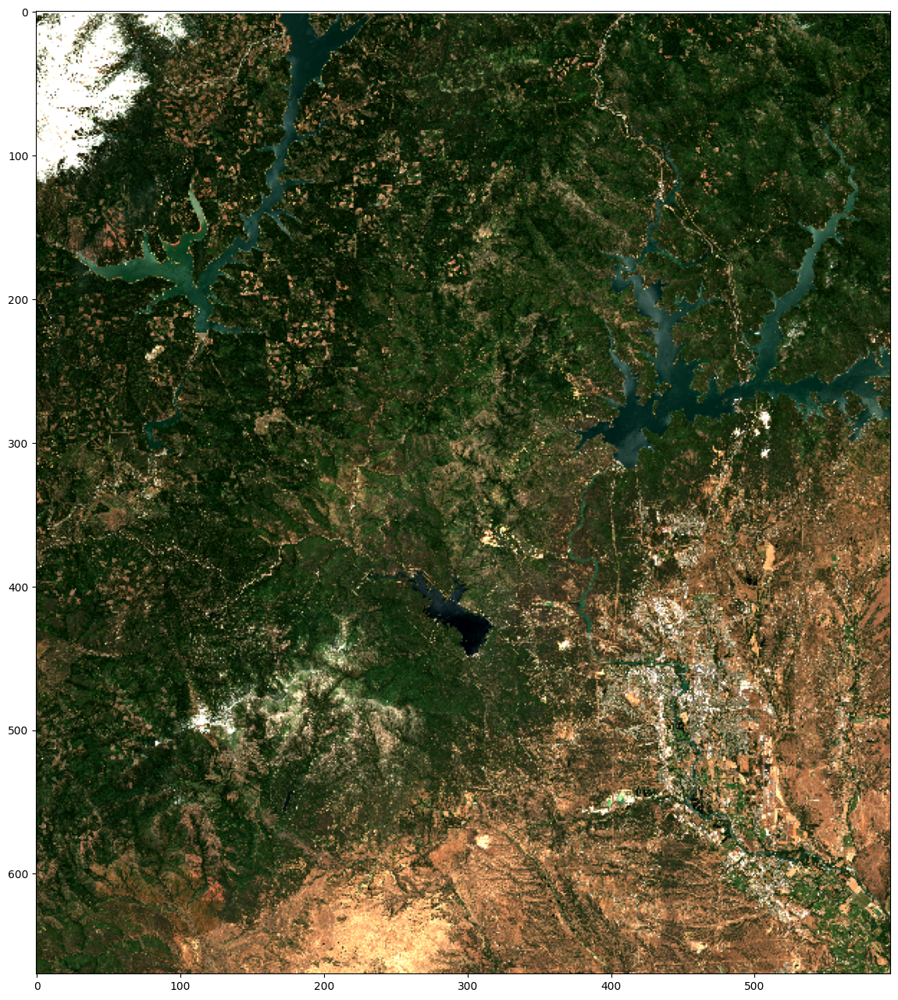

In [62]:
plt.figure(figsize=(16, 16))
plt.imshow(image_pre)

## POST

In [66]:
cube_s2_b2_post = s2_cube_post.filter_bands(bands = ["B02"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
cube_s2_b3_post = s2_cube_post.filter_bands(bands = ["B03"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
cube_s2_b4_post = s2_cube_post.filter_bands(bands = ["B04"]).mean_time().resample_spatial(resolution=100, method="cubicspline")

cube_s2_b2_post.download("./data/post_b2_resampled.tiff")
cube_s2_b3_post.download("./data/post_b3_resampled.tiff")
cube_s2_b4_post.download("./data/post_b4_resampled.tiff")

In [67]:
band2_post=rasterio.open("./data/post_b2_resampled.tiff")
band3_post=rasterio.open("./data/post_b3_resampled.tiff")
band4_post=rasterio.open("./data/post_b4_resampled.tiff")

In [68]:
band2_geo = band2_post.profile
band2_geo.update({"count": 3})

with rasterio.open('rgb_post.tiff', 'w', **band2_geo) as dest:
# I rearanged the band order writting to 2→3→4 instead of 4→3→2
    dest.write(band2_post.read(1),1)
    dest.write(band3_post.read(1),2)
    dest.write(band4_post.read(1),3)

In [69]:
img = rasterio.open('rgb_post.tiff')
image = np.array([img.read(3), img.read(2), img.read(1)]).transpose(1,2,0)
p2, p98 = np.nanpercentile(image, (2,98))
image_post = exposure.rescale_intensity(image, in_range=(p2, p98)) #/ 100000

In [70]:
p2

np.float64(100.3667984008789)

In [71]:
p98

np.float64(1586.9550488281245)

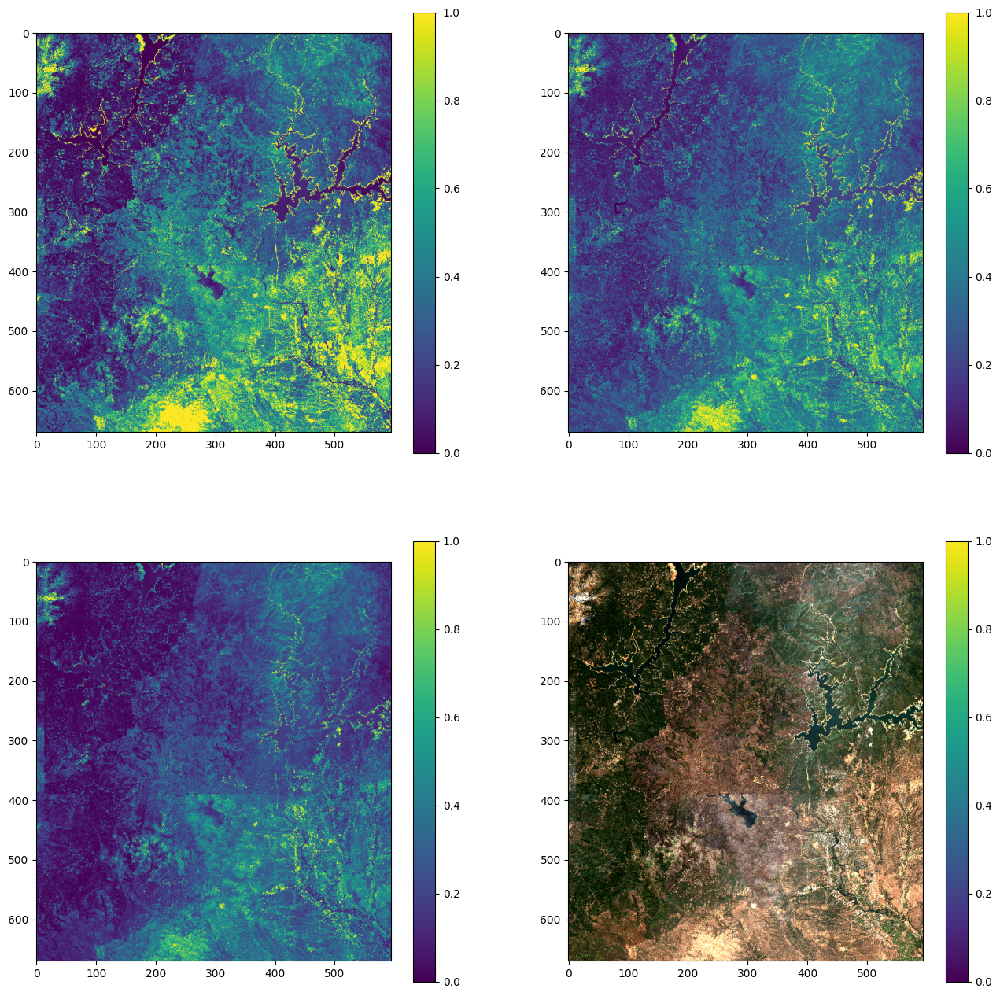

In [72]:
plt.figure(figsize=(16, 16))
plt.subplot(221)
plt.imshow(image_post[:,:,0])
plt.colorbar()
plt.subplot(222)
plt.imshow(image_post[:,:,1])
plt.colorbar()
plt.subplot(223)
plt.imshow(image_post[:,:,2])
plt.colorbar()
plt.subplot(224)
plt.imshow(image_post)
#plt.clim([0,0.2])
plt.colorbar()

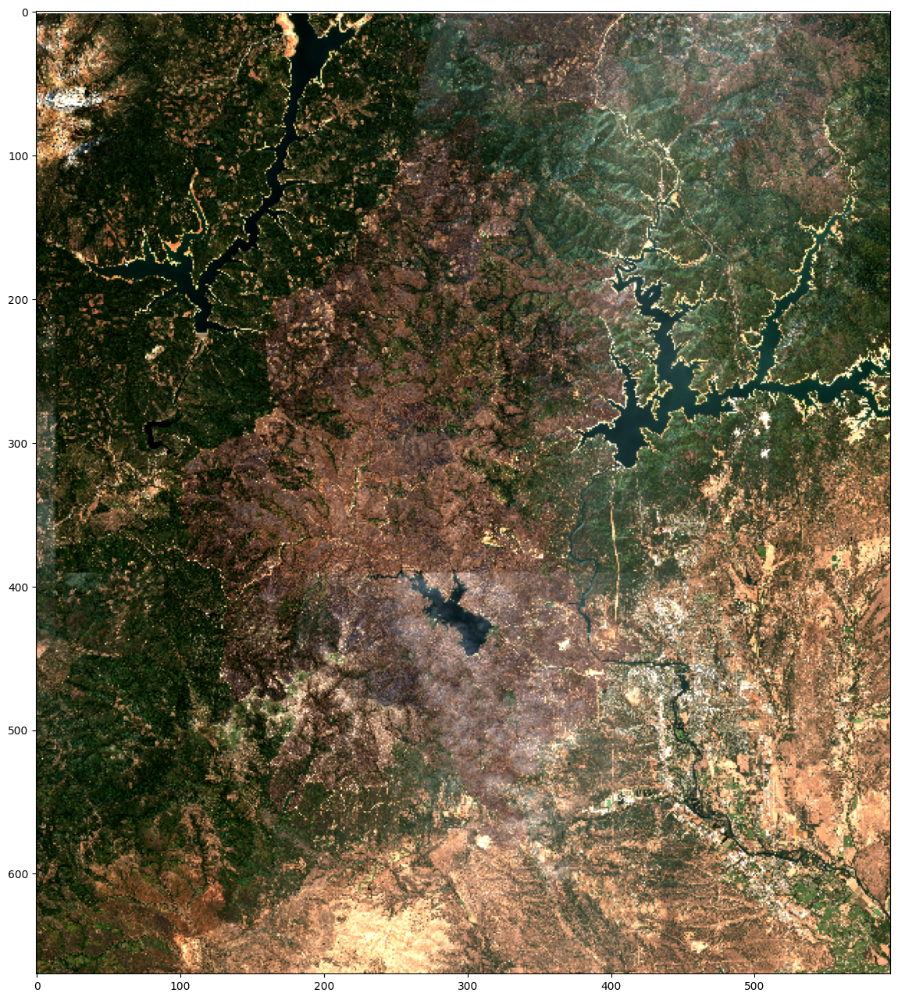

In [73]:
plt.figure(figsize=(16, 16))
plt.imshow(image_post)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


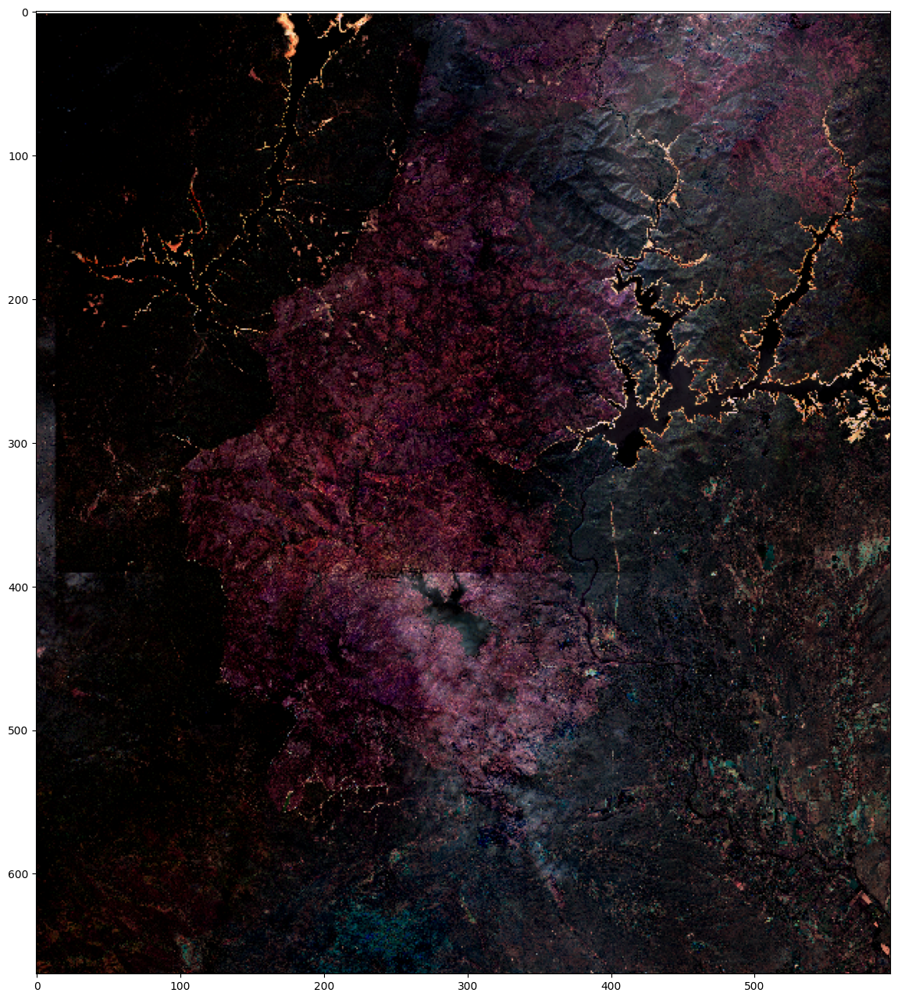

In [74]:
plt.figure(figsize=(16, 16))
plt.imshow(image_post-image_pre)

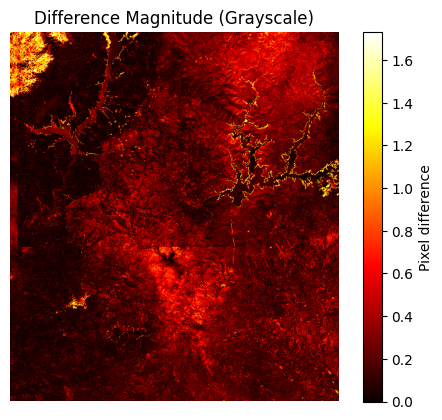

In [75]:
diff_gray = np.linalg.norm(image_post-image_pre, axis=2)  # Euclidean distance across RGB

plt.imshow(diff_gray, cmap='hot')
plt.title("Difference Magnitude (Grayscale)")
plt.colorbar(label='Pixel difference')
plt.axis('off')
plt.show()

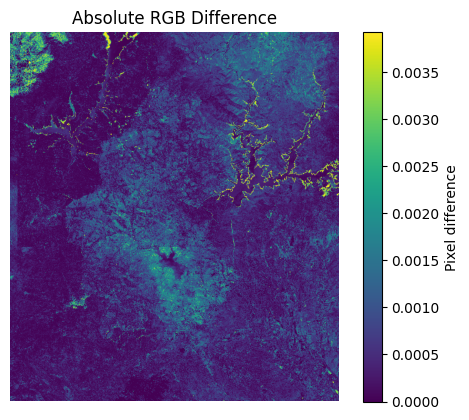

In [79]:
diff = np.abs(image_post[...,0].astype(float) - image_pre[...,0].astype(float)) / 255  # Normalize if needed

plt.imshow(diff)
plt.title("Absolute RGB Difference")
plt.colorbar(label='Pixel difference')
plt.axis('off')
plt.show()

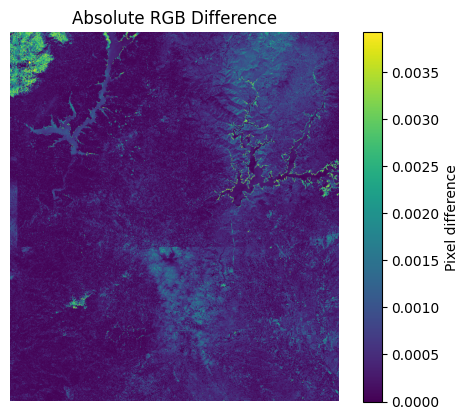

In [80]:
diff = np.abs(image_post[...,1].astype(float) - image_pre[...,1].astype(float)) / 255  # Normalize if needed

plt.imshow(diff)
plt.title("Absolute RGB Difference")
plt.colorbar(label='Pixel difference')
plt.axis('off')
plt.show()

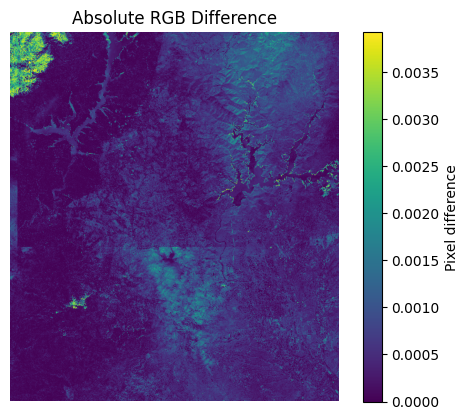

In [81]:
diff = np.abs(image_post[...,2].astype(float) - image_pre[...,2].astype(float)) / 255  # Normalize if needed

plt.imshow(diff)
plt.title("Absolute RGB Difference")
plt.colorbar(label='Pixel difference')
plt.axis('off')
plt.show()

# Analyse the Infrared bands

- identify all IR bands
- figure out what each band shows/properties
- get used to the quantities and typical ranges
- plot difference maps
- nrt investigate smoke
- investigate spectral indices, NBR calculation
- compute land surface temp if possible? or a 1st order estimate?

In [97]:
nir_nrt = s2_cube_nrt.filter_bands(bands=["B08"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
nir_nrt.download("./data/nrt_b8_resampled.tiff")

In [102]:
nir_nrt = rasterio.open("./data/nrt_b8_resampled.tiff").read()

In [103]:
nir_nrt.shape

(1, 670, 595)

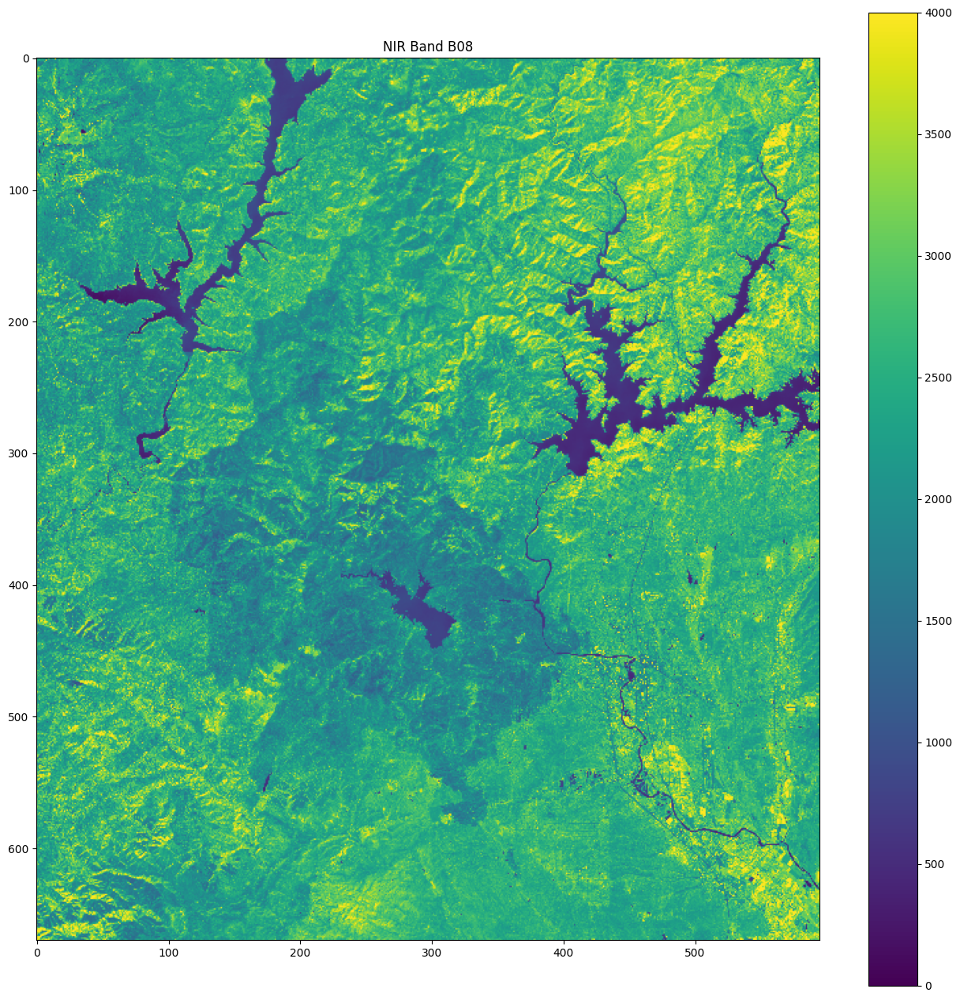

In [106]:
plt.figure(figsize=(16, 16))
plt.imshow(nir_nrt[0])
plt.clim(0,4000)
plt.title('NIR Band B08')
plt.colorbar()
plt.show()

#X and Y dimensions are in 100m resolution steps.

In [118]:
nir8a_nrt = s2_cube_nrt.filter_bands(bands=["B8A"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
nir8a_nrt.download("./data/nrt_b8a_resampled.tiff")

In [ ]:
nir8a_nrt_img = rasterio.open("./data/nrt_b8a_resampled.tiff").read()

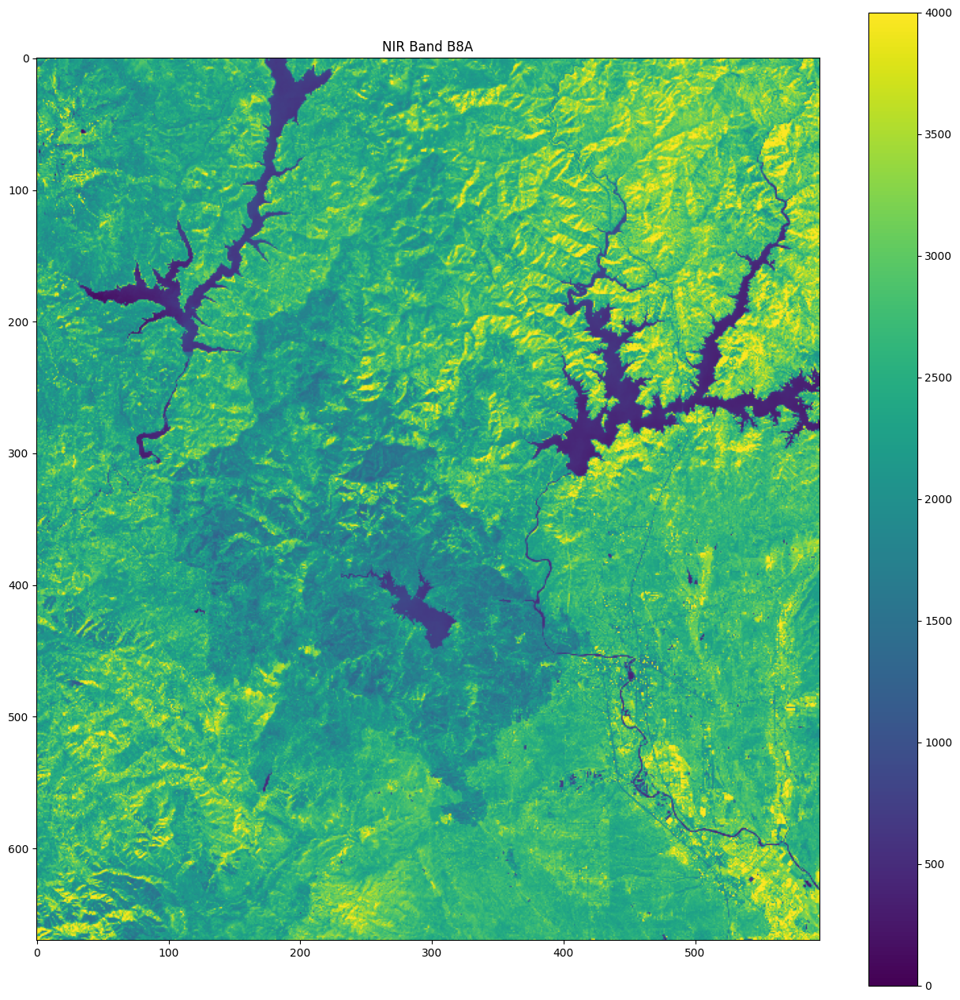

In [ ]:
plt.figure(figsize=(16, 16))
plt.imshow(nir8a_nrt_img[0])
plt.clim(0,4000)
plt.title('NIR Band B8A')
plt.colorbar()
plt.show()


Shortware IR, burnt areas appear darker than unburned land, less SWIR reflected. Can detect hot surfaces and fires through smoke.

In [107]:
swir11_nrt = s2_cube_nrt.filter_bands(bands=["B11"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
swir11_nrt.download("./data/nrt_b11_resampled.tiff")

In [ ]:
swir11_nrt_img = rasterio.open("./data/nrt_b11_resampled.tiff").read()
swir11_nrt_img.shape

(1, 670, 595)

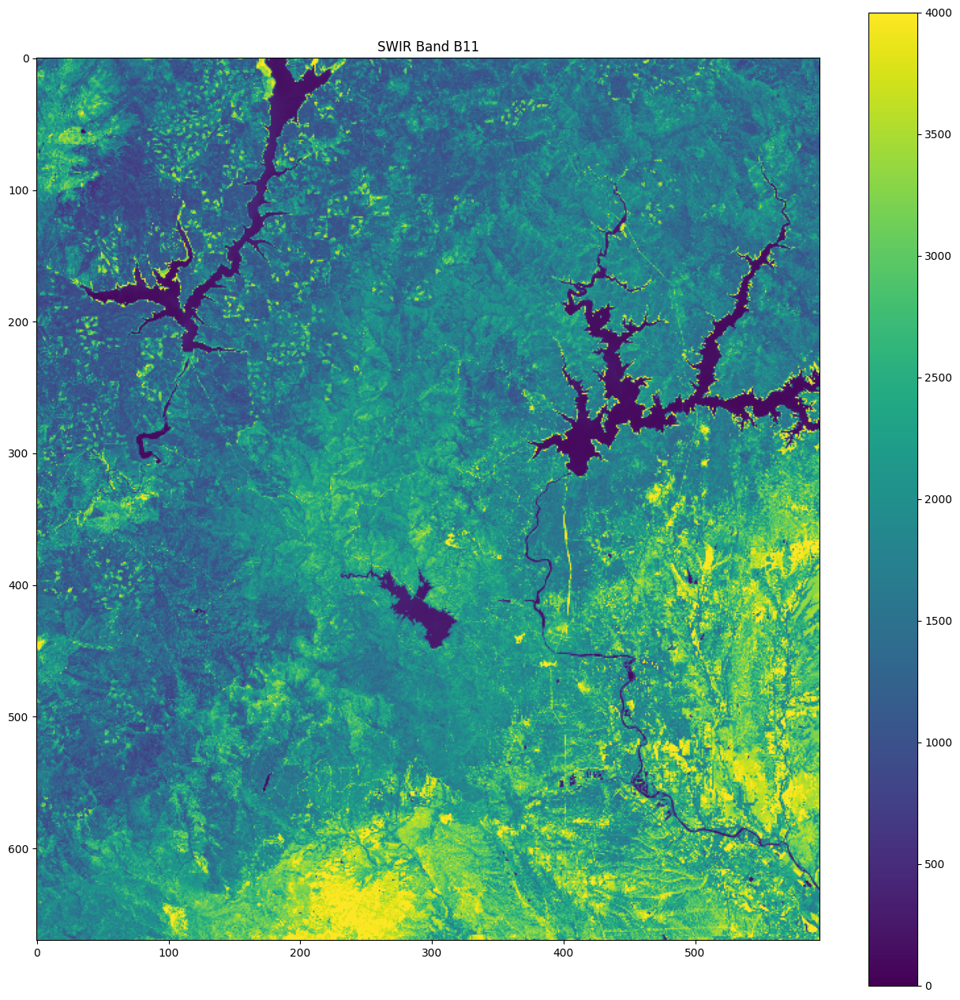

In [ ]:
plt.figure(figsize=(16, 16))
plt.imshow(swir11_nrt_img[0])
plt.clim(0,4000)
plt.title('SWIR Band B11')
plt.colorbar()
plt.show()


In [112]:
swir12_nrt = s2_cube_nrt.filter_bands(bands=["B12"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
swir12_nrt.download("./data/nrt_b12_resampled.tiff")

In [ ]:
swir12_nrt_img = rasterio.open("./data/nrt_b12_resampled.tiff").read()
swir12_nrt_img.shape

(1, 670, 595)

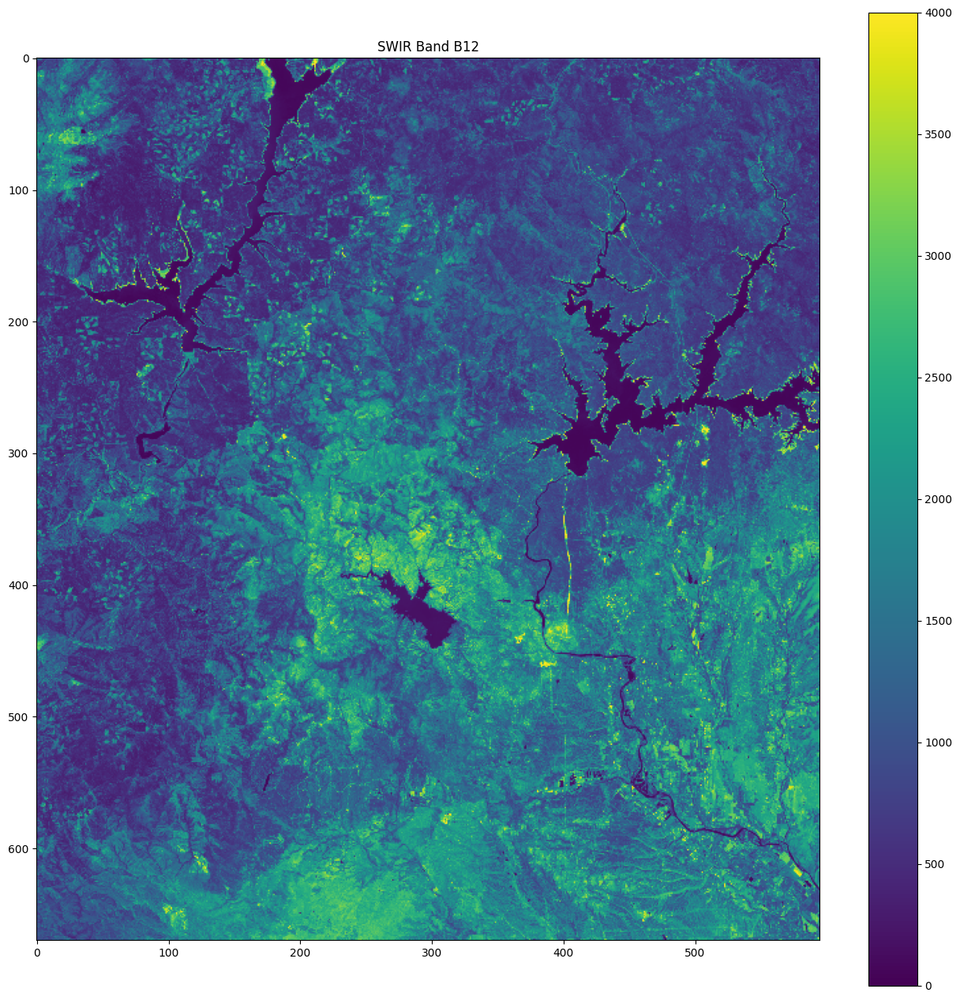

In [ ]:
plt.figure(figsize=(16, 16))
plt.imshow(swir12_nrt_img[0])
plt.clim(0,4000)
plt.title('SWIR Band B12')
plt.colorbar()
plt.show()


In [132]:
image_post.shape

(670, 595, 3)

False color composites: Band 12, 8A, 4 (swir,nir,red)

Burned areas will be dark brown or grey.

In [ ]:
b4_nrt_img = band4.read(1)[np.newaxis,...]  # Add a new axis to match the shape of other bands

In [ ]:
fcc = np.concat((swir12_nrt_img/np.nanmax(swir12_nrt_img), nir8a_nrt_img/np.nanmax(nir8a_nrt_img), b4_nrt_img/np.nanmax(b4_nrt_img)), axis=0)
# normalise the bands to [0:1] range, and ignoring NaN values

In [145]:
fcc = np.moveaxis(fcc, 0, -1)  # Move the first axis to the last position
fcc.shape

(670, 595, 3)

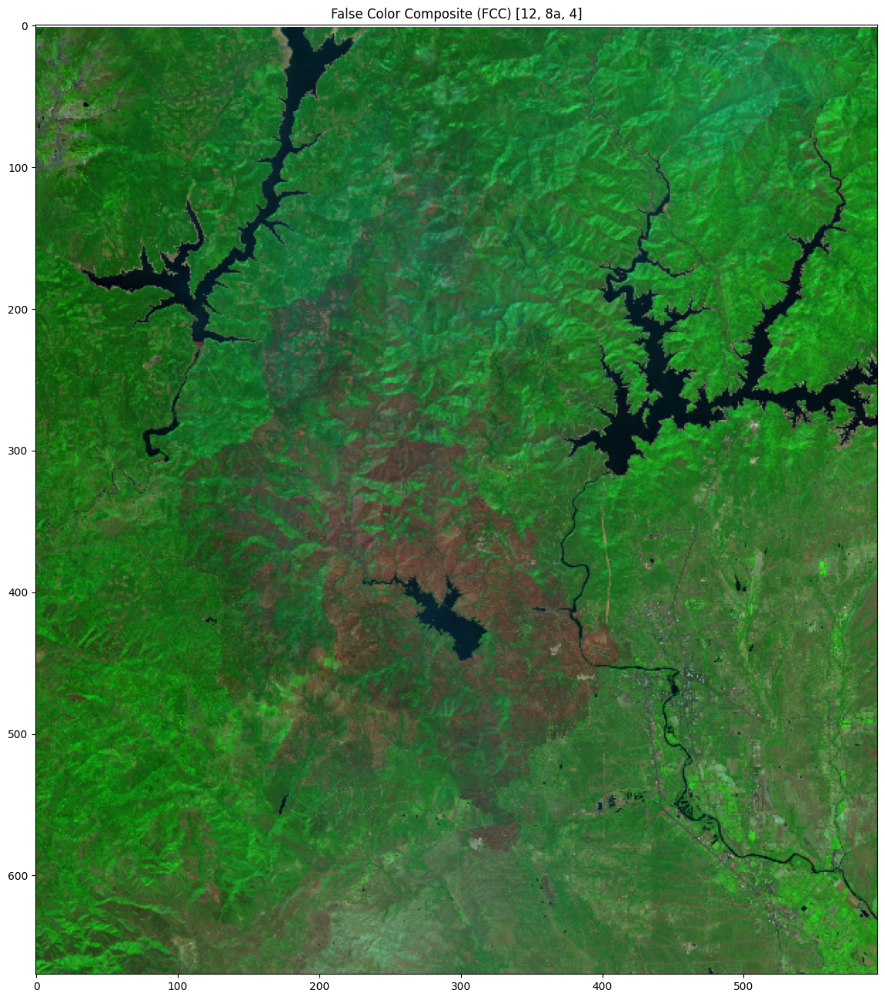

In [ ]:
plt.figure(figsize=(16, 16))
plt.imshow(fcc)
plt.title('False Color Composite (FCC) NRT [12, 8a, 4]')
plt.show()

# Post FCC

In [154]:
swir12_post = s2_cube_post.filter_bands(bands=["B12"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
swir12_post.download("./data/post_b12_resampled.tiff")

nir8a_post = s2_cube_post.filter_bands(bands=["B8A"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
nir8a_post.download("./data/post_b8a_resampled.tiff")

red_post = s2_cube_post.filter_bands(bands=["B04"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
red_post.download("./data/post_b4_resampled.tiff")

In [155]:
swir12_post_img = rasterio.open("./data/post_b12_resampled.tiff").read()
nir8a_post_img = rasterio.open("./data/post_b8a_resampled.tiff").read()
red_post_img = rasterio.open("./data/post_b4_resampled.tiff").read()

In [167]:
n = np.concat((swir12_post_img/np.nanmax(swir12_post_img), nir8a_post_img/np.nanmax(nir8a_post_img), red_post_img/np.nanmax(red_post_img)), axis=0)
fcc_post = np.moveaxis(n, 0, -1)  # Move the first axis to the last position

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007117006..1.0].


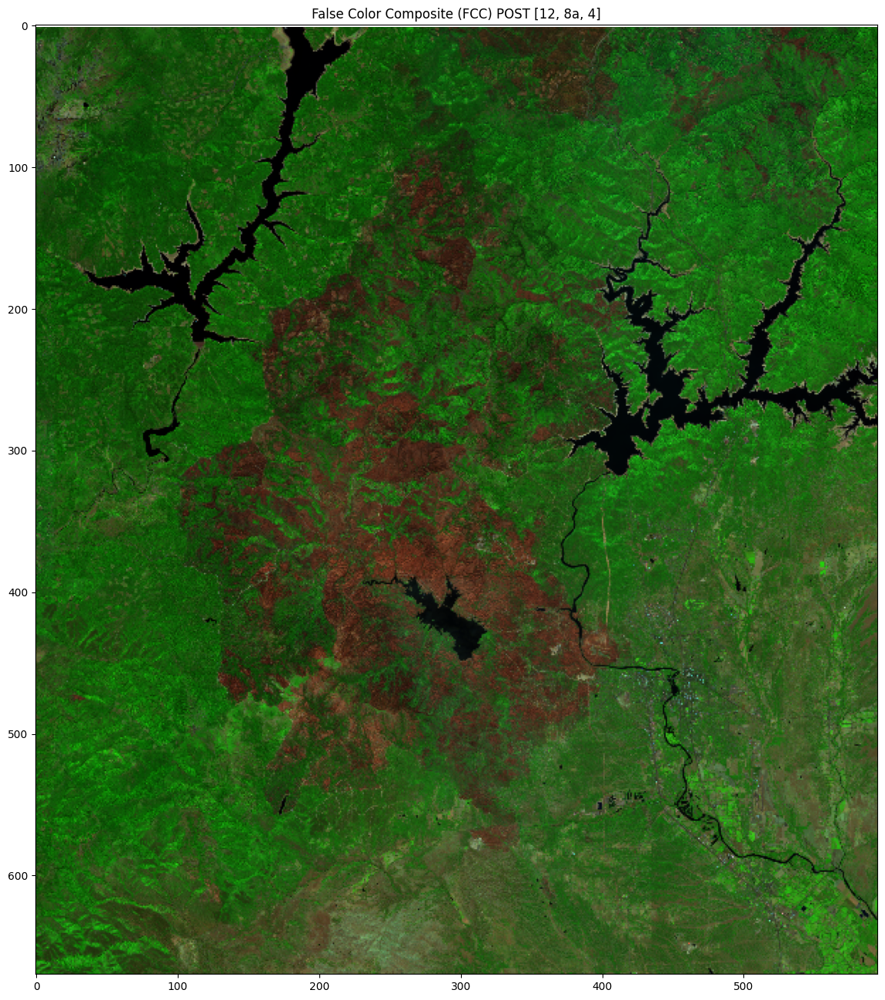

In [168]:
plt.figure(figsize=(16, 16))
plt.imshow(fcc_post)
plt.title('False Color Composite (FCC) POST [12, 8a, 4]')
plt.show()

# PRE FCC

In [170]:
swir12_pre = s2_cube_pre.filter_bands(bands=["B12"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
swir12_pre.download("./data/pre_b12_resampled.tiff")

nir8a_pre = s2_cube_pre.filter_bands(bands=["B8A"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
nir8a_pre.download("./data/pre_b8a_resampled.tiff")

red_pre = s2_cube_pre.filter_bands(bands=["B04"]).mean_time().resample_spatial(resolution=100, method="cubicspline")
red_pre.download("./data/pre_b4_resampled.tiff")


swir12_pre_img = rasterio.open("./data/pre_b12_resampled.tiff").read()
nir8a_pre_img = rasterio.open("./data/pre_b8a_resampled.tiff").read()
red_pre_img = rasterio.open("./data/pre_b4_resampled.tiff").read()
n_pre = np.concat((swir12_pre_img/np.nanmax(swir12_pre_img), nir8a_pre_img/np.nanmax(nir8a_pre_img), red_pre_img/np.nanmax(red_pre_img)), axis=0)
fcc_pre = np.moveaxis(n_pre, 0, -1)  # Move the first axis to the last position

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.009100376..1.0].


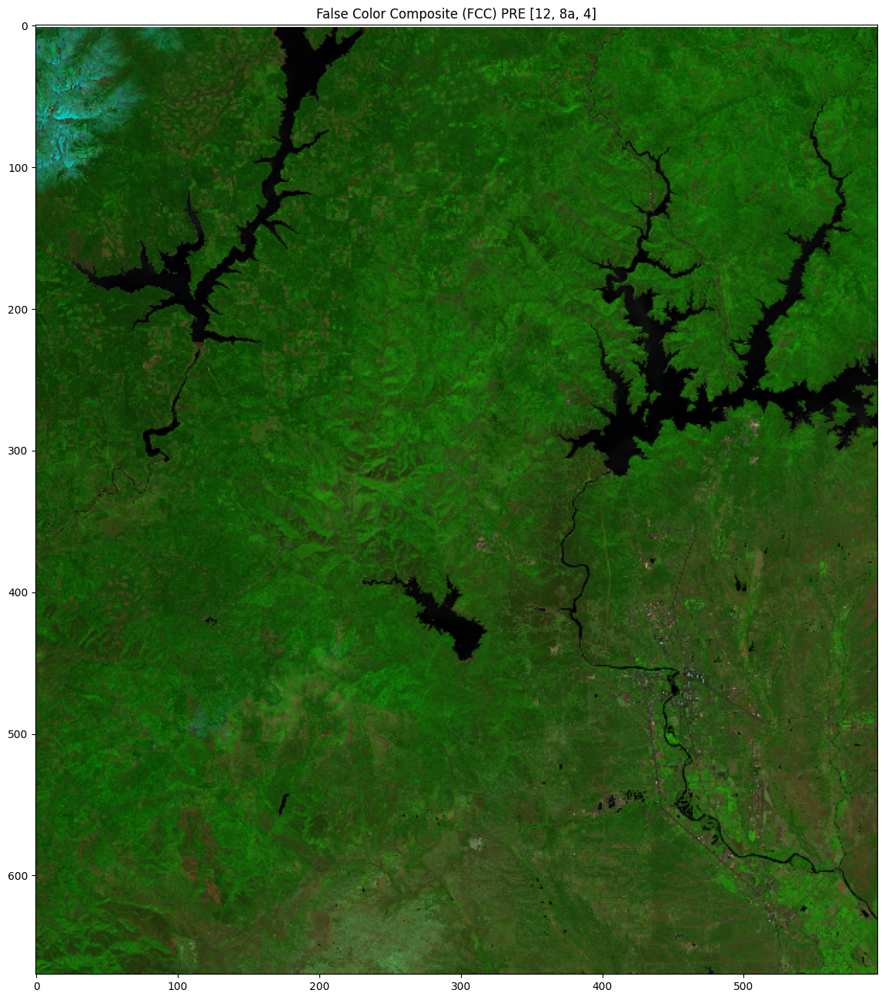

In [171]:
plt.figure(figsize=(16, 16))
plt.imshow(fcc_pre)
plt.title('False Color Composite (FCC) PRE [12, 8a, 4]')
plt.show()

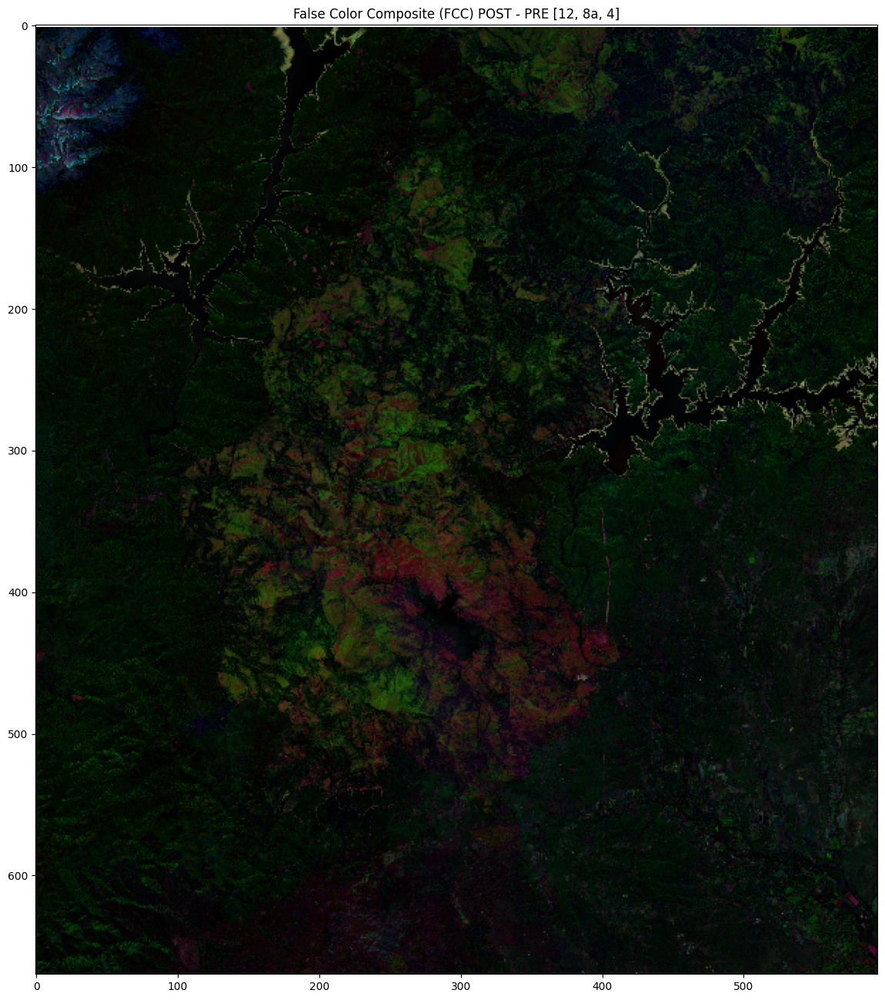

In [174]:
plt.figure(figsize=(16, 16))
plt.imshow(np.abs(fcc_post - fcc_pre))
plt.title('False Color Composite (FCC) POST - PRE [12, 8a, 4]')
plt.show()